<p style="text-align: center; font-size:50px;">DCGAN Tutorial</p>

##### Based on this [website](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html) from PyTorch's official website.

<p style="text-align: center; font-size:50px;">Introduction</p>

#### This tutorial is an introduction to DCGANs through examples.
#### I first was introduced to GANs when studying about PyTorch and how it can generate fake images of people's face who don't exist. 
#### I found this very fascinating and after learning the basics of Deep Learning, I am here to talk about what I have learnt about GANs and PyTorch implementation of it. 

<p style="text-align: center; font-size:50px;">Generative Adversarial Network</p>

<p style="text-align: center; font-size:30px;">What is a GAN?</p>

### GANs were first introduced in 2014 by Ian Goodfellow. 
#### It is basically two models working together, the **generator** and **discriminator**. 
#### The generator generates fake images that closely resemble the training images. 
#### While the generator attempts me come up with fake images, the discriminator will try to discriminate between real and fake images. 
#### Thus, there is a pull and push dynamics between these two models where the generator tries to 'trick' the discriminator while the latter tries to do the opposite. 
#### The equilibrium of this game is when the generator comes up with 'perfect' fakes which can fool the discriminator.
#### To **fool** the discriminator is to say that the discriminator can only randomly decide whether an image is fake or true; 50% success rate. 

### Now let's define some mathematical notations.
#### We let $ x $ be data representing an image.
#### $ D(x) $ is the **discriminator network** which ouputs the probability that $ x $ came from the training data rather than the generator. 
#### So intuitively, when the image comes from the training data, $D(x)$ should be high and low when it comes from the generator.
#### $D(x)$ can be thought of as a traditional binary classifier with probability output, like .predict_proba methods in scikit-learn models.

#### $G(z)$ represents the **generator function**. 
#### We let $z$ be the latent space vector sampled from a standard normal distribution. 
#### The goal of $G$ is to estimate the distribution that the training data comes from, so it can geenrate fake samples from that estimated distribution. 

#### So, $D(G(z))$ is the probability (scalar) that the output of the generator is a real image. 
#### As described in the paper, $D$ and $G$ plays a **minimax** game:
* Discriminator tries to maximize the probability it correctly classifies fake and real images -> $log D(x)$

* Generator tries to minimize the probability that D will predict its outputs are fake -> $log(1-D(G(z)))$

#### From the paper, it states that the GAN Loss Function is as such 
$$\large \min_{G}\max_{D}V(D,G) = \mathbb{E}_{x \sim p_{data}(x)}[logD(x)] + \mathbb{E}_{z \sim p_{z}(z)}[log(1-D(G(z)))]$$
#### where $p_{data}$ is the distribution that the training data comes from and $p_{g}$ is the estimated distribution that makes up the fake images. 

#### In **theory**, the minimax games is where $p_{g} = p_{data}$ and the discriminator has no choice but to randomly guess if the inputs generated by the generator is real or fake.

<p style="text-align: center; font-size:30px;">What is a DCGAN?</p>

#### Now that I explained the basics of a GAN, let's talk about a DCGAN. 
#### DCGAN is a direct extension of a GAN and it stands for **Deep Convolutional Generative Adverserial Networks**.
#### In its discriminators and generators, it uses convolutional and convolutional-transpose layers. 
#### The **discriminator** is made up of strided convolution layers, batch norm layers and LeakyReLU activations. 
#### It takes in a 3x64x64 input image and outputs a scalar probability that the input is from the real data distribution, just like a GAN. 
#### The **generator** is comprised of convolutional-transpose layers, batch norm layers, and ReLU activations. 
#### It takes in a latent vector, $z$, that is drawn from a standard normal distribution and outputs a 3x64x64 image. 

#### Before proceeding on further with more explanation, let's set up some basic code blocks. 

In [31]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torch.utils.data import Dataset as Dataset
from PIL import Image
import os
from dotenv import load_dotenv

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


<p style="text-align: center; font-size:30px;">Inputs</p>

#### Let's define some inputs for the run.

In [2]:
# Number of workers for dataloader
workers = 1

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 0

#### Let's attempt to visualize some of our training data.

In [46]:
load_dotenv()
path_to_image = os.getenv('PATH_FILE')

# Create Custom Dataset (202599 images in total)
transforming = transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ])

class GAN(Dataset):
    def __init__(self):
        self.root = path_to_image
        self.transform = transforming
        self.total_len = 202599
        
    def __len__(self):
        return self.total_len
    
    def __getitem__(self, idx):

        idx += 1
        
        str_idx = (6 - len(str(idx)))*'0' + str(idx)
        
        img = self.transform(Image.open(self.root + str_idx + '.jpg'))
            
        return img

dataset = GAN()


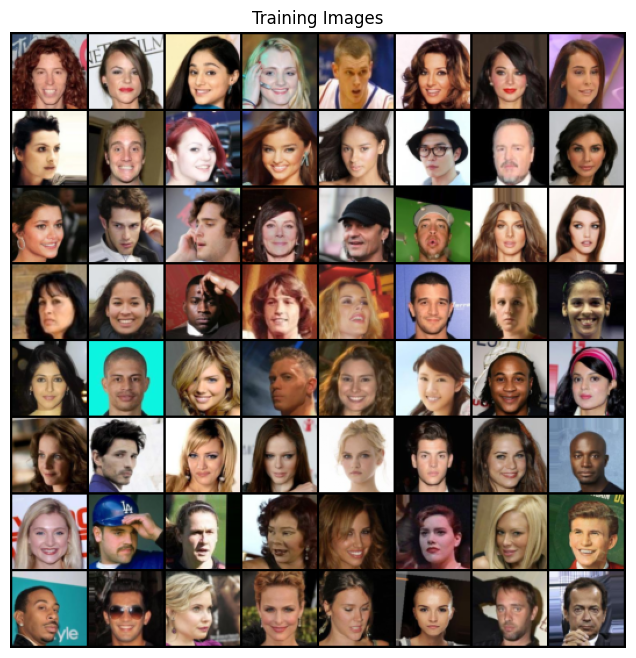

In [47]:
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True)

# Decide which device we want to run on
device = torch.device("mps")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [5]:
image= next(iter(dataloader))

print(f"Image shape: {image.shape} -> [batch_size, color_channels, height, width]")

Image shape: torch.Size([128, 3, 64, 64]) -> [batch_size, color_channels, height, width]


<p style="text-align: center; font-size:50px;">Implementation</p>

#### First, let's talk about the weight initialization strategy.

<p style="text-align: center; font-size:30px;">Weight Initialization</p>

#### From the paper, it is stated that the model weights should be randomly initialized from a Normal distribution with mean = 0, stdev=0.2. 
#### The weights_init function below takes an initialized model as input and reinitializes all convolutional, convolutional-tranpose, and batch normalization layers to meet this criteria. 

In [6]:
def weights_init(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)

<p style="text-align: center; font-size:30px;">Generator</p>

#### Let's now talk about the Generator. 
#### The Generator, $G$ is designed to map the latent space vector ($z$) to data space. 
#### Since we would have to output an image, we would have to convert $z$ to a RGB image with the same size as the training images (3x64x64).
#### In pratice, this is done by a series of strided 2 dimensional convolutional transpose layers, each paired with a 2d batch norm layer and a ReLU activation function. 
### The 2d batch norm functions after the conv-tranpose layers are a critical aspect of the model architecture as they help with the flow of gradients during training.
#### The output is fed through a tanh function to return it to the input data range of [-1,1].


In [7]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

netG = Generator().to(device)

netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


#### The parameters, nz, ngf, and nc influence the architecture of the model. 
#### *nz* is the length of the $z$ input vector.
#### *ngf* relates to the size of the feature maps that are propagated throughout the generator.
#### *nc* is the number of channels in the final output image, which in this case is 3. 

<p style="text-align: center; font-size:30px;">Discriminator</p>

#### The Discriminator $D$, is a binary classification network that takes an image as input and outputs a scalar probability that the input image is real or fake. 
#### Taking in a 3x64x64 image, it processes it through a series of Conv2d, BatchNorm2d, and LeakyReLU layers, and outputs the final probability through a Sigmoid activation function, so that it's within the range of [0,1].
#### The batch norm and leaky relu functions promote healthy gradient flow which is critical for the learning process of both G and D. 

In [8]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

netD = Discriminator().to(device)

netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


<p style="text-align: center; font-size:30px;">Loss Functions and Optimizers</p>

#### For the loss function, we will use the Binary Cross Entropy loss function (BCELoss).
$$\large -[y_{n} \cdot log(x_{n}) + (1-y_{n}) \cdot log(1-x_{n}))] $$
#### This will help us calculate both log components in the objective function.
$$\large log(D(x)) $$ 
$$\large  log(1-D(G(z))) $$

#### Next we have to define our real label as 1 and the fake label as 0. 
#### These labels will be used when calculating the losses of D and G.
#### Finally, we set up 2 separate optimizers, one for D and one for G. 
#### In the paper, Adam optimizers with lr of 0.0002 and Beta1 = 0.5 is used. 
#### For the latent vectors, we will draw them from a Gaussian distribution. 
#### In the training loop, these vectors will be fed into the Generators and we will see images form out of the noise.

In [9]:
criterion = nn.BCELoss()

# Creating batch of latent vectors to visualize the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device = device)

real_label = 1.
fake_label = 0. 

optimizerD = optim.Adam(netD.parameters(), lr = lr, betas = (beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas = (beta1, 0.999))

<p style="text-align: center; font-size:30px;">Training</p>

#### Now that we have established the basics, we can go ahead with training the GAN. 
#### To produce the most optimal results, we will closely follow the paper. 
#### Training is split up into 2 main parts. 
#### Part 1 updates the Discriminator while Part 2 updates the Generator.

<p style="text-align: center; font-size:30px;">Training the Discriminator</p>

#### The **goal** of training the discriminator is to maximize the probability of correctly classifying a given input as real or fake. 
#### Pratically, we wish to maximize $log(D(x)) + log(1-D(G(z)))$
#### First, we will construct a batch of real samples from the training set, forward pass through D, calculate the loss $log(D(x))$, then calculate the gradients in a backward pass. 
#### Secondly, we will construct a batch of fake samples with the current generator, forward pass this batch through D, calculate the loss $log(1-D(G(z)))$, and accumulate the gradients with a backward pass. 
#### Now with the gradients from both steps, we call a step of the Discriminator's optimizer.

<p style="text-align: center; font-size:30px;">Training the Generator</p>

#### The **goal** of training the Generator is to produce the best fake images. 
#### We have to minimize $log(1-D(G(z)))$ to generate these better fakes. 
#### This was shown, however, that it does not provide sufficient gradients. 
#### Therefore, we wish to maximize $log(D(G(z)))$ instead. 
#### We accomplish this by classifying the Generator output from above with the Discriminator, computing G's loss using real labels as GT, computing G's gradients in a backward pass, and finally updating G's parameters with an optimizer step. 

<p style="text-align: center; font-size:30px;">Training loop</p>

In [10]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################

        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/5][0/1583]	Loss_D: 1.9650	Loss_G: 5.4520	D(x): 0.5758	D(G(z)): 0.6573 / 0.0067
[0/5][50/1583]	Loss_D: 0.0059	Loss_G: 37.1396	D(x): 0.9953	D(G(z)): 0.0000 / 0.0000
[0/5][100/1583]	Loss_D: 0.0005	Loss_G: 38.8337	D(x): 0.9995	D(G(z)): 0.0000 / 0.0000
[0/5][150/1583]	Loss_D: 0.0009	Loss_G: 36.7955	D(x): 0.9992	D(G(z)): 0.0000 / 0.0000
[0/5][200/1583]	Loss_D: 0.7143	Loss_G: 4.7210	D(x): 0.9140	D(G(z)): 0.3649 / 0.0170
[0/5][250/1583]	Loss_D: 1.0271	Loss_G: 8.1731	D(x): 0.9444	D(G(z)): 0.5830 / 0.0006
[0/5][300/1583]	Loss_D: 0.9384	Loss_G: 5.5343	D(x): 0.8744	D(G(z)): 0.4936 / 0.0069
[0/5][350/1583]	Loss_D: 1.2000	Loss_G: 6.4536	D(x): 0.9011	D(G(z)): 0.5433 / 0.0107
[0/5][400/1583]	Loss_D: 0.5837	Loss_G: 3.9355	D(x): 0.7841	D(G(z)): 0.2133 / 0.0378
[0/5][450/1583]	Loss_D: 1.2119	Loss_G: 4.8104	D(x): 0.4297	D(G(z)): 0.0026 / 0.0335
[0/5][500/1583]	Loss_D: 0.6448	Loss_G: 4.0540	D(x): 0.6761	D(G(z)): 0.0479 / 0.0356
[0/5][550/1583]	Loss_D: 0.8326	Loss_G: 5.1305	D(x)

<p style="text-align: center; font-size:50px;">Results</p>

#### Ok, let's check out how we did. 
#### We'll see how D and G's losses changed during training. 
#### And then, we'll visualize on the fixed_noise batch for every epoch. 
#### And then, we will look at a batch of real data next to a batch of fake data from G.

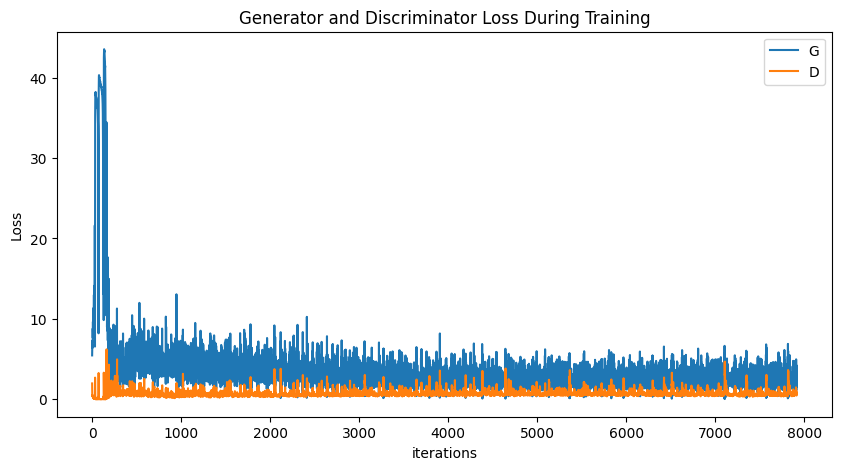

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

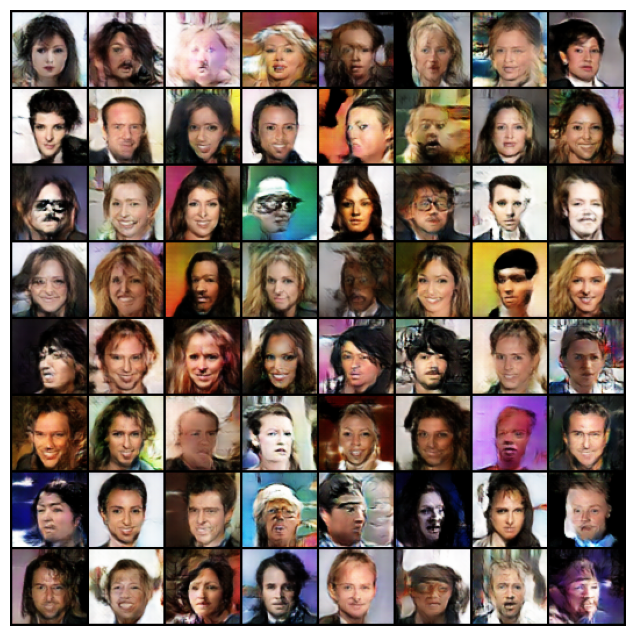

In [12]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

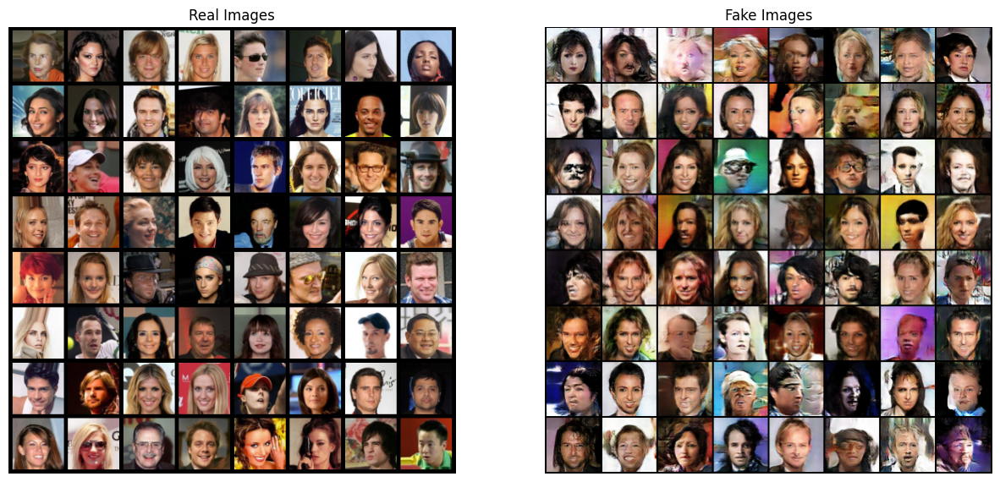

In [22]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()